In [1]:
import pandas as pd
import numpy as np
import sys
from pyspark.sql import functions as f
import re
from functools import reduce
from pyspark.sql import SparkSession
from typing import Dict
from pyspark.sql.types import StructType, StructField, StringType, IntegerType, TimestampType, FloatType
from pandas.tseries.offsets import MonthEnd
from datetime import datetime
import re
from pyspark.sql.window import Window
import plotly.express as px
from pyspark.ml.feature import Bucketizer
from itertools import chain
from pandas.tseries.offsets import MonthEnd
from dateutil.relativedelta import relativedelta
pd.set_option('display.max_columns', 200)

In [2]:
df = pd.read_parquet('escrow_assets.parquet')

In [3]:
df['Статус счета'].unique()

array(['Закрыт', 'На подтверждении', 'Открыт', '-'], dtype=object)

In [4]:
df.columns

Index(['objectid', 'number_clean', 'number', 'complexId', 'developerId',
       'groupId', 'address_additionalInfo', 'address_building',
       'address_district', 'address_domain', 'address_house', 'address_letter',
       'address_localityName', 'address_localityType', 'address_region_code',
       'address_region_name', 'address_streetName', 'address_streetType',
       'address_unit', 'addressString', 'buildRegion_code', 'buildRegion_name',
       'latitude', 'longitude', 'livingArea', 'objectStatus_code',
       'objectStatus_name', 'projectDeclaration_number',
       'commissioningPlanDate', 'issuedate', 'issuedby', 'Дата открытия счета',
       'Плановая дата окончания', 'Код Филиала', 'Код ТП', 'Статус счета',
       'Номер счета эскроу', 'Текущий остаток по счету',
       'в т.ч. собственные средства', 'в т.ч. ипотечные средства',
       'Наименование получателя', 'ИНН получателя', 'БИК банка получателя',
       'Расчетный счет получателя', 'Номер ДДУ', 'Дата ДДУ',
       'Адр

In [28]:
df['Номер счета эскроу'][df['objectid'].isin(mdf2['objectid'].unique())].nunique()

229463

In [20]:
df['Сумма по ДДУ'].describe()

count    2.708340e+05
mean     7.362943e+06
std      7.305857e+07
min      0.000000e+00
25%      2.419000e+06
50%      4.639957e+06
75%      8.659864e+06
max      3.705093e+10
Name: Сумма по ДДУ, dtype: float64

In [21]:
df['ОГРН застройщика'].nunique()

557

In [22]:
df['developerId'].nunique()

523

In [26]:
mdf2[].nunique()

659

In [25]:
df['objectid'].nunique()

941

## Анализ заявленных и проданных площадей

In [11]:
def anomaly_detect(df, cols, fill = False):
    for col in cols:
        q25 = df[col].quantile(0.25)
        q75 = df[col].quantile(0.75)
        IQR = q75 - q25
        if fill:
            get_val = lambda arr, f: arr.agg(f) if len(arr) > 0 else None
            df.loc[:, col] = df[col].mask(df[col] < q25 - 1.5*IQR, get_val(df[col][df[col] >= q25 - 1.5*IQR], 'min'))
            df.loc[:, col] = df[col].mask(df[col] > q75 + 1.5*IQR, get_val(df[col][df[col] <= q75 + 1.5*IQR], 'max'))
        else:   
            df = df[df[col].between(q25 - 1.5*IQR, q75 + 1.5*IQR)]
    return df


def get_monthly_df(df):
    # Фильтруем выбросы:
    df = df.groupby(['objectid'], as_index = False).apply(lambda df: anomaly_detect(df, ['Площадь объекта ДДУ, м2'], fill = True)).reset_index(drop = True).assign(
                                                            price_per_metr = df['Сумма по ДДУ'] / df['Площадь объекта ДДУ, м2'])
    df = df.groupby(['objectid'], as_index = False).apply(
                                lambda df: anomaly_detect(df, ['Дата выдачи разрешения на строительство', 'price_per_metr'], fill = True)).reset_index(drop = True)
    # Корректируем объем после фильтрации выбросов:
    df.loc[:, 'Сумма по ДДУ'] = df.loc[:, 'price_per_metr'] * df.loc[:, 'Площадь объекта ДДУ, м2']
    
    df = df.assign(report_date = df['Дата открытия счета'].map(lambda dt: dt + MonthEnd(0)))
    
    df = df.groupby(['objectid', 'report_date'], as_index = False).apply(
                                lambda df: anomaly_detect(df, ['Плановая дата окончания', 'Фактическая дата закрытия счета'], fill = True)).reset_index(drop = True)
    
    cols_dict = {
        'Сумма по ДДУ': (lambda df: df['Сумма по ДДУ'][~df['price_per_metr'].isna()].sum(), 'escrow_inflow'),
        'Площадь объекта ДДУ, м2': (lambda df: df['Площадь объекта ДДУ, м2'][~df['price_per_metr'].isna()].sum(), 'S_inflow'), 
        'LivingArea': ('max', 'S_object'),
        'issuedate': (lambda df: pd.to_datetime(df).min(), 'object_open_date'),
        'commissioningPlanDate': (lambda df: pd.to_datetime(df).max(), 'object_close_date'),
        'Плановая дата окончания': ('max', 'escrow_plan_close'),
        'Фактическая дата закрытия счета': ('max', 'escrow_fact_close'),
        'Дата выдачи разрешения на строительство': ('min', 'escrow_object_open_date'),
        'Статус счета': (lambda df: df.mode()[0] if len(df.mode()) > 0 else None, 'escrow_status'),
        'buildRegion_code': (lambda df: df.mode()[0] if len(df.mode()) > 0 else None, 'region_num'),
        'price_per_metr': (lambda df: df['Сумма по ДДУ'][~df['price_per_metr'].isna()].sum() / df['Площадь объекта ДДУ, м2'][~df['price_per_metr'].isna()].sum(), 'mean_price_per_metr'),
        'latitude': (lambda df: df.mode()[0] if len(df.mode()) > 0 else None, 'latitude'),
        'longitude': (lambda df: df.mode()[0] if len(df.mode()) > 0 else None, 'longitude')
    }
    renamed_cols = [col[1] for k, col in cols_dict.items()]
    cols_for_apply = ['Сумма по ДДУ', 'Площадь объекта ДДУ, м2', 'price_per_metr']
    
    df = df.groupby(['objectid', 'report_date'], as_index = False).apply(lambda df: df.assign(**{k: v[0](df) for k, v in cols_dict.items() if k in cols_for_apply})).reset_index(drop = True)
    
    df = df.groupby(['objectid', 'report_date'], as_index = False).agg({k: v[0] if k not in cols_for_apply else 'first' for k, v in cols_dict.items()})
    
    df = df.rename(columns = {k: v[1] for k, v in cols_dict.items()})
    
    df = df.groupby('objectid').apply(lambda df: df.merge(pd.DataFrame({'report_date': pd.date_range(df['report_date'].min(), df['report_date'].max(), freq = 'M')}),
                                            on = 'report_date', how = 'outer').fillna({col: 0 if col in ['S_inflow', 'escrow_inflow'] \
                                                                                       else df[col].mode()[0] if len(df[col].mode()) > 0 else np.nan
                             for col in ['objectid', *renamed_cols] if col not in ['escrow_plan_close', 'escrow_fact_close']})).reset_index(drop = True)

    df = df.sort_values('report_date')
    df = df.groupby('objectid').apply(lambda df: df.assign(escrow_volume = df['escrow_inflow'].cumsum(), S_volume = df['S_inflow'].cumsum(),
                                    escrow_max_plan_close = df['escrow_plan_close'].max(), escrow_max_fact_close = df['escrow_fact_close'].max(), 
                                    escrow_object_min_open_date = df['escrow_object_open_date'].min(), escrow_status = df['escrow_status'].mode()[0])
                                                          ).reset_index(drop = True)
    
    #print('aaa', df.groupby('objectid').apply(lambda df: df['escrow_status'].nunique()))
    
    def get_correct_dates(df, open_th_l=31, open_th_r=1500, open_th_bn=600 , close_th_r=450, close_th_bn = 150):
        min_report_date = df['report_date'].min()
        esc_open_date = df['escrow_object_min_open_date'].iloc[0]
        obj_open_date = df['object_open_date'].iloc[0]
        if open_th_l <= (min_report_date - max(esc_open_date, obj_open_date)).days <= open_th_r:
            if ((min_report_date - obj_open_date).days <= open_th_r) and ((esc_open_date - obj_open_date).days < open_th_bn): 
                open_date = obj_open_date
            else:
                open_date = esc_open_date
                print('zalupa1')
        elif open_th_l <= (min_report_date - min(esc_open_date, obj_open_date)).days <= open_th_r:
            open_date = min(esc_open_date, obj_open_date)
        else:
            if (min_report_date - max(esc_open_date, obj_open_date)).days > open_th_r:
                open_date = min_report_date - relativedelta(days = open_th_r)
                print('zalupa2')
            else:
                open_date = min_report_date - relativedelta(days = open_th_l)
                print('zalupa3')
        
        status = df['escrow_status'].iloc[0]
        max_report_date = df['report_date'].max()
        max_plan_close = df['escrow_max_plan_close'].iloc[0]
        max_fact_close = df['escrow_max_fact_close'].iloc[0]
        obj_close_date = df['object_close_date'].iloc[0]
        
        if status == 'Закрыт':
            
            if 0 <= (min(obj_close_date, max_fact_close) - max_report_date).days <= close_th_r:
                if ((obj_close_date - max_report_date).days <= close_th_r) and ((obj_close_date - max_fact_close).days < close_th_bn): 
                    close_date = obj_close_date
                else:
                    close_date = max_fact_close
            elif 0 <= (max(obj_close_date, max_fact_close) - max_report_date).days <= close_th_r:
                close_date = max(obj_close_date, max_fact_close)
            else:
                if (min(obj_close_date, max_fact_close) - max_report_date).days > close_th_r:
                    close_date = max_report_date + relativedelta(days = close_th_r)
                else:
                    # TODO: Возможно стоит пересмотреть статус проекта 
                    close_date = max_report_date
        
        else:
            if (min(obj_close_date, max_plan_close) - max_report_date).days >= 0:
                close_date = obj_close_date
            elif (max(obj_close_date, max_plan_close) - max_report_date).days >= 0:
                close_date = max(obj_close_date, max_plan_close)
            else:
                close_date = max_report_date + relativedelta(days = 31)
        
        
        return df.assign(open_date = open_date, close_date = close_date, escrow_min_open_dt = min_report_date, escrow_max_open_dt = max_report_date)
                
            
    df = df.groupby('objectid').apply(lambda df: get_correct_dates(df)).reset_index(drop = True)
    
    df = df.groupby('objectid').apply(lambda df: df.merge(pd.DataFrame({'report_date': pd.date_range(df['open_date'].iloc[0] + MonthEnd(0), df['close_date'].iloc[0] + MonthEnd(0), freq = 'M')}),
                                            on = 'report_date', how = 'outer').fillna({col: df[col].mode()[0] if len(df[col].mode()) > 0 else np.nan
                             for col in ['objectid', 'object_open_date', 'object_close_date', 'escrow_max_plan_close', 'escrow_max_fact_close','escrow_object_min_open_date', 
                                         'S_object', 'open_date', 'close_date', 'escrow_min_open_dt', 'escrow_max_open_dt','escrow_status', 'region_num', 'latitude', 'longitude'] 
                                                                                    })).reset_index(drop = True)#.drop(columns = ['open_date', 'close_date'])
    
    
    cols_to_fill = ['escrow_volume', 'S_volume']
    df = pd.concat([
        df[df['report_date'] > df['escrow_max_open_dt'].max()], 
        df[df['report_date'] <= df['escrow_max_open_dt'].max()].sort_values('report_date').groupby('objectid').apply(
                        lambda df: df.assign(**{col: df[col].ffill() for col in cols_to_fill}).fillna({col: 0 for col in cols_to_fill}).reset_index(drop = True))
                   ])
    
    df = df.groupby('objectid').apply(lambda df: df.assign(**{'S_escrow/S_object': df['S_volume'].max() / df['S_object'].max(), 'S_escrow': df['S_volume'].max()})).reset_index(drop = True)
    
    df = df[(df['S_escrow/S_object'].between(0.5, 1.5) & (df['escrow_status'] == 'Закрыт')) |
            ((df['S_escrow/S_object'] < 1) & (df['escrow_status'] != 'Закрыт'))]
    
    join_targets = lambda df, S_col: df.assign(S_share = df['S_volume'] / df[S_col], S = df[S_col])
    df = pd.concat([
        join_targets(df[df['escrow_status'] == 'Закрыт'], 'S_escrow'),
        join_targets(df[df['escrow_status'] != 'Закрыт'], 'S_object')
    ])
    
    return df


mdf2 = get_monthly_df(df)

/opt/cloudera/parcels/AnacondaPy37/envs/python3.7.9/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: invalid value encountered in double_scalars


zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa1
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa2
zalupa1
zalupa2
zalupa2
zalupa2
zalupa3
zalupa3
zalupa3
zalupa3
zalupa2
zalupa2
zalupa2
zalupa3
zalupa1
zalupa2
zalupa3
zalupa2
zalupa3
zalupa3
zalupa1
zalupa3
zalupa3
zalupa2
zalupa3
zalupa3
zalupa2
zalupa2
zalupa2
zalupa2
zalupa3
zalupa3
zalupa3
zalupa3
zalupa1
zalupa1
zalupa3
zalupa3
zalupa2
zalupa3
zalupa2
zalupa2
zalupa3
zalupa3
zalupa2
zalupa3
zalupa2
zalupa3
zalupa2
zalupa3
zalupa3
zalupa3
zalupa3
zalupa3
zalupa3
zalupa3
zalupa3
zalupa2
zalupa2
zalupa2
zalupa3
zalupa3
zalupa3
zalupa2
zalupa2
zalupa3
zalupa2
zalupa2
zalupa3
zalupa3
zalupa3
zalupa2
zalupa3
zalupa3


/opt/cloudera/parcels/AnacondaPy37/envs/python3.7.9/lib/python3.7/site-packages/ipykernel_launcher.py:136: RuntimeWarning: divide by zero encountered in double_scalars


In [15]:
mdf2.to_parquet('prepared_df.parquet')

In [12]:
mdf2.count()

objectid                       24047
report_date                    24047
escrow_inflow                  13054
S_inflow                       13054
S_object                       24047
object_open_date               24047
object_close_date              24047
escrow_plan_close              12130
escrow_fact_close              10373
escrow_object_open_date        13054
escrow_status                  24047
region_num                     24047
mean_price_per_metr            13054
latitude                       23650
longitude                      23650
escrow_volume                  22441
S_volume                       22441
escrow_max_plan_close          24047
escrow_max_fact_close          22014
escrow_object_min_open_date    24047
open_date                      24047
close_date                     24047
escrow_min_open_dt             24047
escrow_max_open_dt             24047
S_escrow/S_object              24047
S_escrow                       24047
S_share                        22441
S

In [5]:
mdf2 = pd.read_parquet('prepared_df.parquet')

In [62]:
mdf2.

,objectid,report_date,escrow_inflow,S_inflow,S_object,object_open_date,object_close_date,escrow_plan_close,escrow_fact_close,escrow_object_open_date,escrow_status,mean_price_per_metr,escrow_volume,S_volume,escrow_max_plan_close,escrow_max_fact_close,escrow_object_min_open_date,open_date,close_date
0,25800.0,2018-11-30,2.020286e+08,0.00,20279.00,2018-09-19,2020-12-31,2021-06-30,2020-09-09,2018-09-19,Закрыт,142814.000000,2.020286e+08,2.020286e+08,2021-06-30,2020-11-10,2018-09-19,2018-09-19,2020-12-31
1,14036.0,2018-12-31,4.500000e+06,0.00,21729.64,2017-04-19,2021-12-31,2022-06-30,2021-12-30,2017-04-19,Закрыт,56923.061580,4.500000e+06,4.500000e+06,2022-09-30,2021-12-30,2017-04-19,2017-04-19,2021-12-31
2,25800.0,2018-12-31,1.501704e+08,0.00,20279.00,2018-09-19,2020-12-31,2021-06-30,2020-09-09,2018-09-19,Закрыт,142814.000000,3.521991e+08,3.521991e+08,2021-06-30,2020-11-10,2018-09-19,2018-09-19,2020-12-31
3,27445.0,2018-12-31,2.882278e+09,0.00,79888.82,2018-11-09,2021-12-31,2022-04-30,2021-09-24,2018-11-09,Закрыт,101809.180294,2.882278e+09,2.882278e+09,2022-06-30,2021-09-24,2018-11-09,2018-11-09,2021-12-31
4,26144.0,2018-12-31,2.637810e+06,0.00,48061.70,2018-06-28,2023-12-31,2023-12-28,2021-09-27,2018-06-28,Закрыт,48199.129220,2.637810e+06,2.637810e+06,2024-06-28,2021-09-27,2018-06-28,2018-06-28,2021-09-30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16040,45973.0,2024-02-29,4.573808e+08,1252.20,65718.80,2021-11-03,2025-09-30,2026-03-30,NaT,2021-11-03,Открыт,334277.153047,5.638152e+10,5.638152e+10,2026-03-31,2024-02-01,2021-11-03,2021-11-03,2025-09-30
16041,44436.0,2024-02-29,1.162430e+08,237.10,21629.20,2021-12-24,2024-09-30,2025-03-30,NaT,2021-12-24,Открыт,313662.166667,7.509181e+09,7.509181e+09,2025-07-01,2024-01-25,2021-12-24,2021-12-24,2024-09-30
16042,45157.0,2024-02-29,4.884000e+06,123.60,2998.80,2022-02-11,2023-09-30,2024-06-30,2024-02-15,2022-02-11,Закрыт,39528.227895,3.585368e+08,3.585368e+08,2024-06-30,2024-02-15,2022-02-11,2022-02-11,2024-02-29
16043,42714.0,2024-02-29,4.656918e+07,164.64,23525.60,2021-06-30,2024-06-30,2024-12-30,NaT,2021-06-30,Открыт,232956.380059,7.669277e+09,7.669277e+09,2024-12-31,2024-01-17,2021-06-30,2021-06-30,2024-06-30


In [31]:
mdf2.groupby('objectid').apply(lambda df: df['escrow_status'].nunique()).max()

1

In [28]:
mdf2['escrow_status'].count()

16045

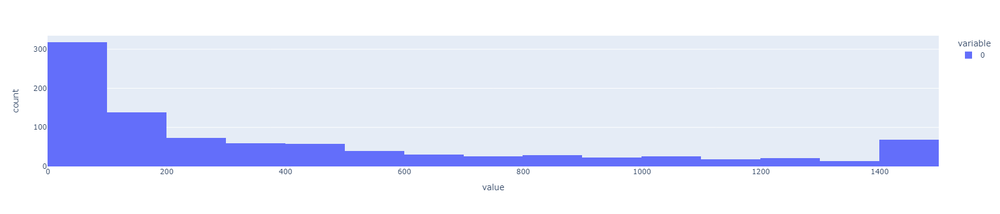

In [25]:
px.histogram((mdf2.groupby('objectid').agg({'report_date': 'min', 'escrow_min_open_dt': 'min'})['escrow_min_open_dt'] - \
              mdf2.groupby('objectid').agg({'report_date': 'min', 'escrow_min_open_dt': 'min'})['report_date']).map(lambda dt: dt.days))

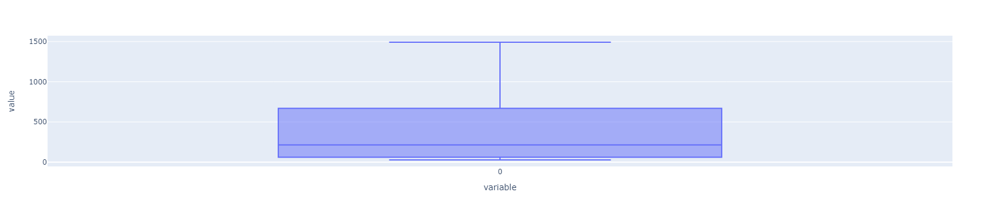

In [26]:
px.box((mdf2.groupby('objectid').agg({'report_date': 'min', 'escrow_min_open_dt': 'min'})['escrow_min_open_dt'] - \
              mdf2.groupby('objectid').agg({'report_date': 'min', 'escrow_min_open_dt': 'min'})['report_date']).map(lambda dt: dt.days))

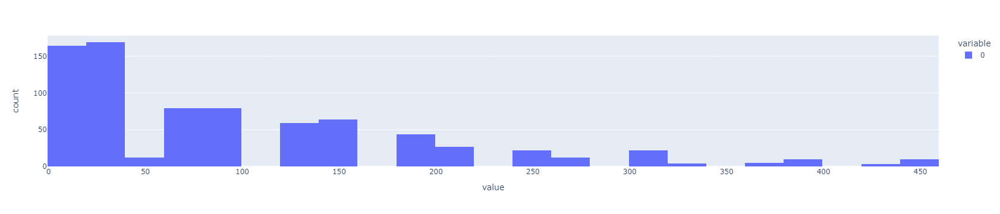

In [28]:
px.histogram((mdf2[mdf2['escrow_status'] == 'Закрыт'].groupby('objectid').agg({'report_date': 'max', 'escrow_max_open_dt': 'max'})['report_date'] - \
              mdf2[mdf2['escrow_status'] == 'Закрыт'].groupby('objectid').agg({'report_date': 'max', 'escrow_max_open_dt': 'max'})['escrow_max_open_dt']).map(lambda dt: dt.days))

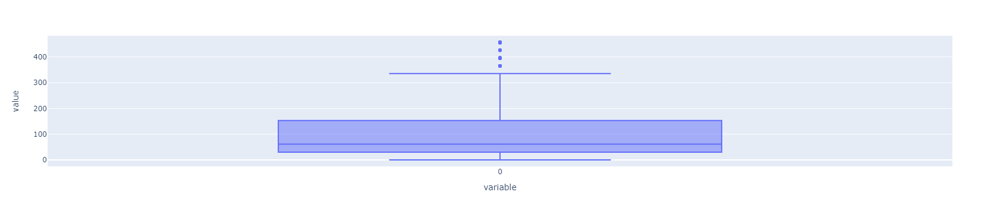

In [29]:
px.box((mdf2[mdf2['escrow_status'] == 'Закрыт'].groupby('objectid').agg({'report_date': 'max', 'escrow_max_open_dt': 'max'})['report_date'] - \
              mdf2[mdf2['escrow_status'] == 'Закрыт'].groupby('objectid').agg({'report_date': 'max', 'escrow_max_open_dt': 'max'})['escrow_max_open_dt']).map(lambda dt: dt.days))

In [40]:
mdf2['escrow_status'].unique()

array(['Закрыт', 'Открыт', 'На подтверждении', '-'], dtype=object)

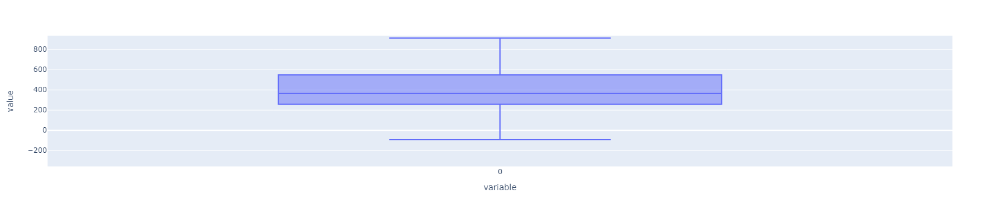

In [38]:
px.box((mdf2[mdf2['escrow_status'] != 'Закрыт'].groupby('objectid').agg({'escrow_max_plan_close': 'max', 'object_close_date': 'max'})['escrow_max_plan_close'] - mdf2[mdf2['escrow_status'] != 'Закрыт'].groupby('objectid').agg(
    {'escrow_max_plan_close': 'max', 'object_close_date': 'max'})['object_close_date']).map(lambda dt: dt.days))

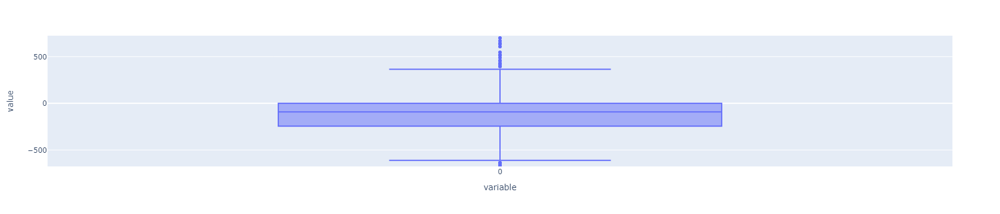

In [34]:
px.box((mdf2.groupby('objectid').agg({'report_date': 'max', 'object_close_date': 'max'})['report_date'] - mdf2.groupby('objectid').agg(
    {'report_date': 'max', 'object_close_date': 'max'})['object_close_date']).map(lambda dt: dt.days))

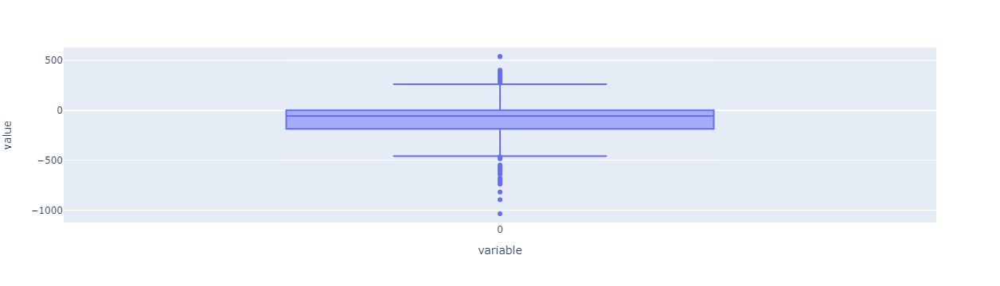

In [36]:
px.box((mdf2.groupby('objectid').agg({'report_date': 'max', 'escrow_fact_close': 'max'})['report_date'] - mdf2.groupby('objectid').agg(
    {'report_date': 'max', 'escrow_fact_close': 'max'})['escrow_fact_close']).map(lambda dt: dt.days))

In [58]:
mdf2

,objectid,report_date,escrow_inflow,S_inflow,S_object,object_open_date,object_close_date,escrow_plan_close,escrow_fact_close,escrow_object_open_date,escrow_status,region_num,mean_price_per_metr,escrow_volume,S_volume,escrow_max_plan_close,escrow_max_fact_close,escrow_object_min_open_date,open_date,close_date,escrow_min_open_dt,escrow_max_open_dt,S_escrow/S_object
0,783.0,2019-11-30,2823636.0,56.36,22768.19,2017-05-16,2022-06-30,2022-06-16,2020-01-27,2017-05-16,Закрыт,23,50100.0,2823636.0,2823636.0,2022-06-16,2020-01-27,2017-05-16,2017-05-16,2020-01-27,2019-11-30,2019-11-30,124.016709
1,783.0,2017-05-31,NaN,NaN,NaN,2017-05-16,2022-06-30,NaT,NaT,NaT,Закрыт,23,NaN,2823636.0,2823636.0,2022-06-16,2020-01-27,2017-05-16,2017-05-16,2020-01-27,2019-11-30,2019-11-30,124.016709
2,783.0,2017-06-30,NaN,NaN,NaN,2017-05-16,2022-06-30,NaT,NaT,NaT,Закрыт,23,NaN,2823636.0,2823636.0,2022-06-16,2020-01-27,2017-05-16,2017-05-16,2020-01-27,2019-11-30,2019-11-30,124.016709
3,783.0,2017-07-31,NaN,NaN,NaN,2017-05-16,2022-06-30,NaT,NaT,NaT,Закрыт,23,NaN,2823636.0,2823636.0,2022-06-16,2020-01-27,2017-05-16,2017-05-16,2020-01-27,2019-11-30,2019-11-30,124.016709
4,783.0,2017-08-31,NaN,NaN,NaN,2017-05-16,2022-06-30,NaT,NaT,NaT,Закрыт,23,NaN,2823636.0,2823636.0,2022-06-16,2020-01-27,2017-05-16,2017-05-16,2020-01-27,2019-11-30,2019-11-30,124.016709
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33742,46217.0,2022-07-31,NaN,NaN,NaN,2021-12-28,2023-12-31,NaT,NaT,NaT,Закрыт,16,NaN,433600008.0,433600008.0,2024-07-01,2024-02-19,2021-12-28,2021-12-28,2024-02-29,2022-12-31,2024-02-29,54879.755370
33743,46217.0,2022-08-31,NaN,NaN,NaN,2021-12-28,2023-12-31,NaT,NaT,NaT,Закрыт,16,NaN,433600008.0,433600008.0,2024-07-01,2024-02-19,2021-12-28,2021-12-28,2024-02-29,2022-12-31,2024-02-29,54879.755370
33744,46217.0,2022-09-30,NaN,NaN,NaN,2021-12-28,2023-12-31,NaT,NaT,NaT,Закрыт,16,NaN,433600008.0,433600008.0,2024-07-01,2024-02-19,2021-12-28,2021-12-28,2024-02-29,2022-12-31,2024-02-29,54879.755370
33745,46217.0,2022-10-31,NaN,NaN,NaN,2021-12-28,2023-12-31,NaT,NaT,NaT,Закрыт,16,NaN,433600008.0,433600008.0,2024-07-01,2024-02-19,2021-12-28,2021-12-28,2024-02-29,2022-12-31,2024-02-29,54879.755370


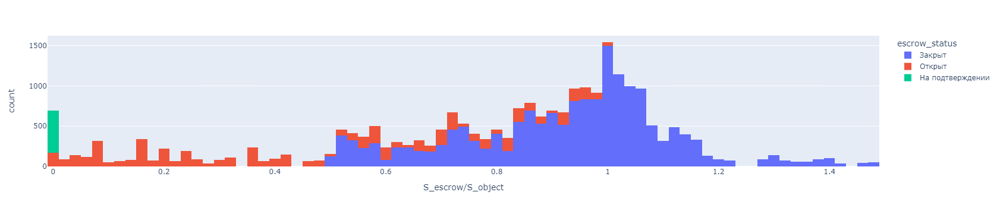

In [102]:
px.histogram(mdf2, x = 'S_escrow/S_object', color = 'escrow_status')

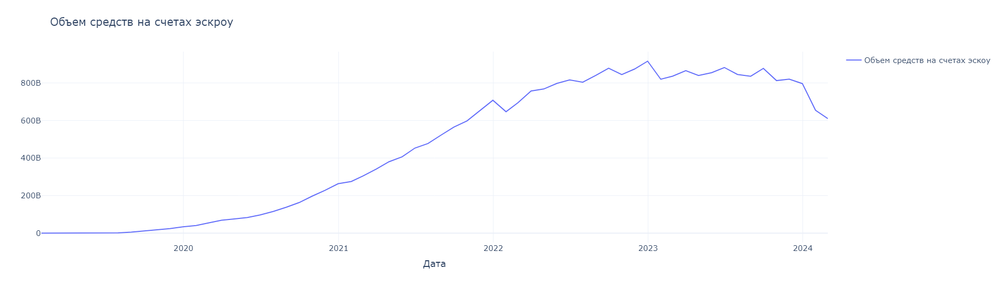

In [11]:
import plotly.io as pio
pio.templates.default = 'plotly_white'

fig = px.line(mdf2[mdf2['report_date'].between(pd.to_datetime('2019-01-01'), pd.to_datetime('2024-03-01'))].groupby('report_date').agg({'escrow_volume': 'sum'}).rename(columns = {'escrow_volume': 'Объем средств на счетах эскоу'}),
        title = 'Объем средств на счетах эскроу', height = 550)

fig.update_layout(font = dict(size = 15), xaxis_title = 'Дата', yaxis_title = '', legend_title = '')

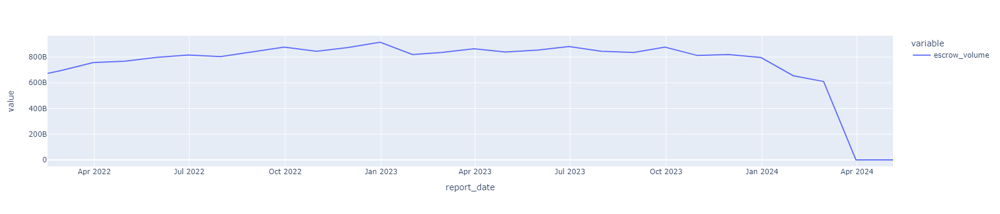

In [14]:
px.line(mdf2.groupby('report_date').agg({'escrow_volume': 'sum'}))

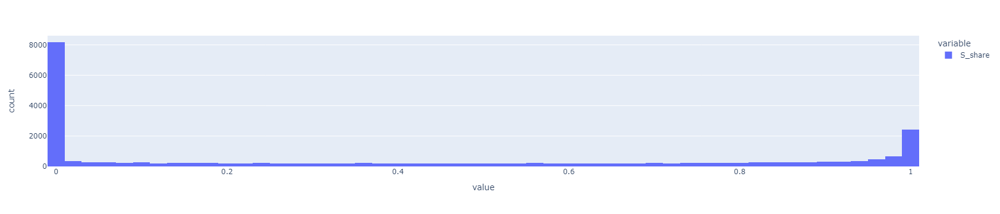

In [104]:
px.histogram(mdf2['S_share'])

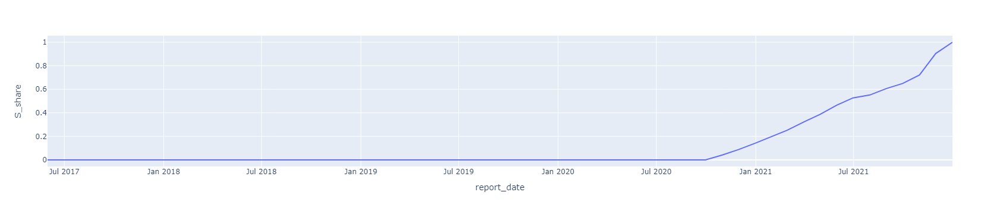

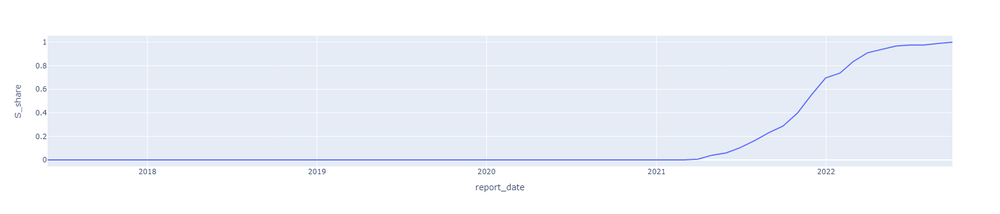

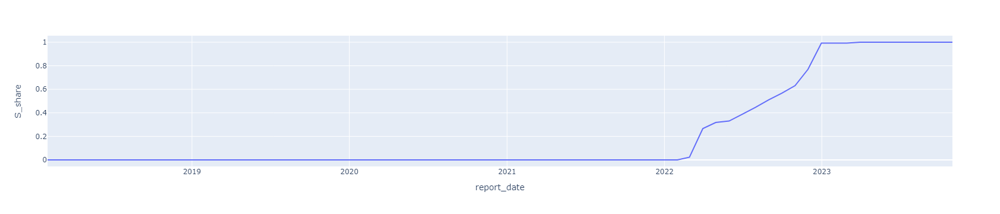

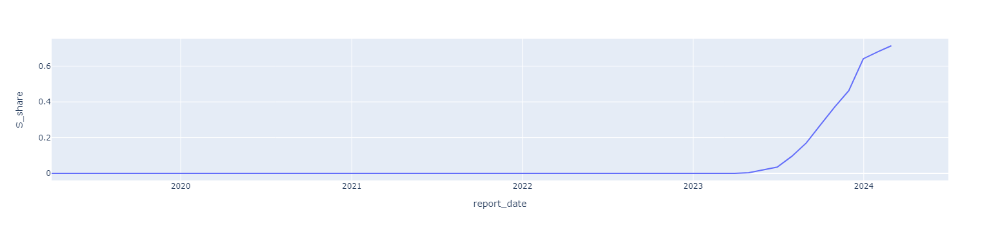

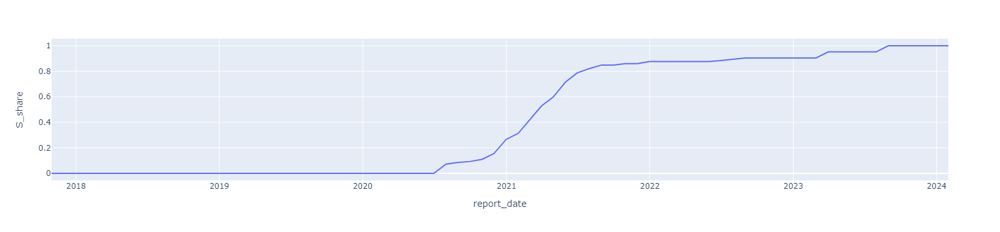

...

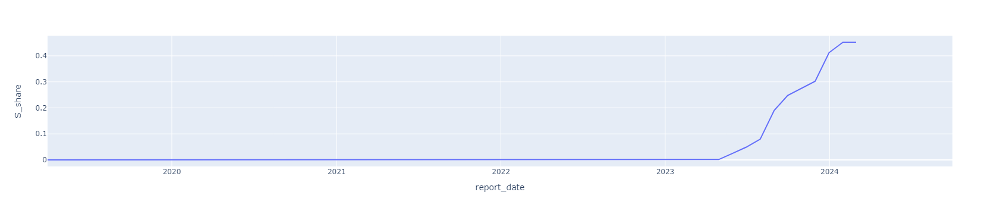

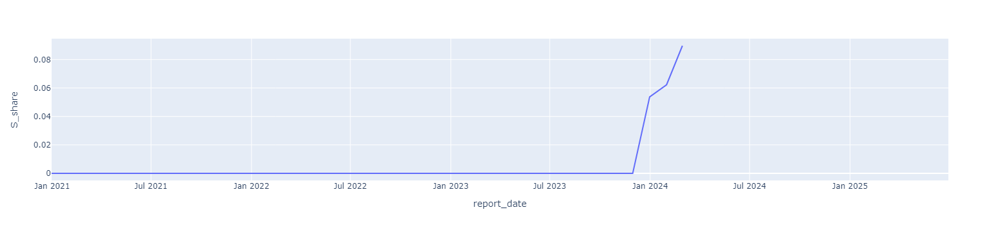

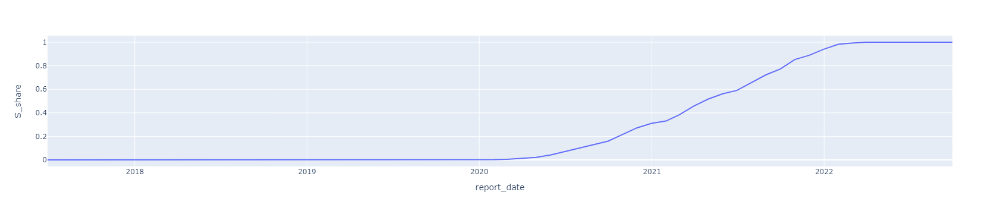

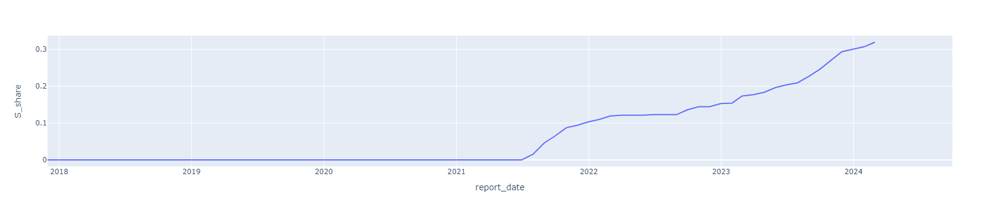

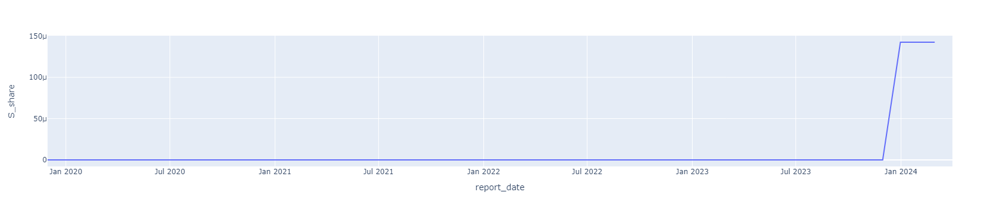

In [105]:
nums = 10
cur = 0
for obj, df in mdf2.groupby('objectid'):
    if cur <= nums:
        px.line(df, x = 'report_date', y = 'S_share').show()
    cur += 1


In [20]:
(mdf2['object_close_date'] - mdf2['escrow_max_plan_close']).groupby(mdf2['object_close_date'] - mdf2['escrow_max_plan_close']).count().nlargest(20)

-365 days    1115
-366 days     990
-183 days     864
-547 days     857
-364 days     806
-184 days     739
-546 days     725
-274 days     692
-181 days     681
-273 days     596
-182 days     582
-548 days     509
-457 days     335
-639 days     292
-456 days     282
-549 days     261
-275 days     260
-367 days     220
-458 days     209
-912 days     157
dtype: int64

In [449]:
mdf1['object_open_date'].min()

Timestamp('2008-02-12 00:00:00')

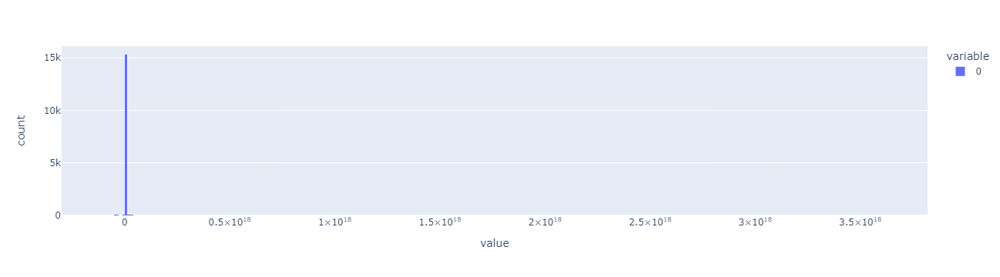

In [437]:
px.histogram(mdf1['object_open_date'] - mdf1['escrow_object_open_date'])

In [440]:
(mdf1['object_close_date'] - mdf1['plan_close_escrow']).quantile(0.75)

Timedelta('-181 days +00:00:00')

In [419]:
mdf['report_date'].min()

Timestamp('2018-11-30 00:00:00')

In [371]:
def anomaly_detect(df, cols, fill = False):
    for col in cols:
        q25 = df[col].quantile(0.25)
        q75 = df[col].quantile(0.75)
        IQR = q75 - q25
        if fill:
            get_val = lambda arr, f: arr.agg(f) if len(arr) > 0 else None
            df.loc[:, col] = df[col].mask(df[col] < q25 - 1.5*IQR, get_val(df[col][df[col] >= q25 - 1.5*IQR], 'min'))
            df.loc[:, col] = df[col].mask(df[col] > q75 + 1.5*IQR, get_val(df[col][df[col] <= q75 + 1.5*IQR], 'max'))
        else:   
            df = df[df[col].between(q25 - 1.5*IQR, q75 + 1.5*IQR)]
    return df

df_f = df.groupby(['objectid'], as_index = False).apply(lambda df: anomaly_detect(df, ['Площадь объекта ДДУ, м2'], fill = True)).reset_index(drop = True).assign(
                                                            price_per_metr = df_f['Сумма по ДДУ'] / df_f['Площадь объекта ДДУ, м2'])

In [358]:
df['livingArea'].agg('min')

0.0

In [404]:
S = df_f.groupby(['objectid']).agg({'Площадь объекта ДДУ, м2': 'sum', 'Статус счета': 'min',
                                    'livingArea': lambda df: df.abs().max(),
                                   'LivingArea': lambda df: df.abs().max()})

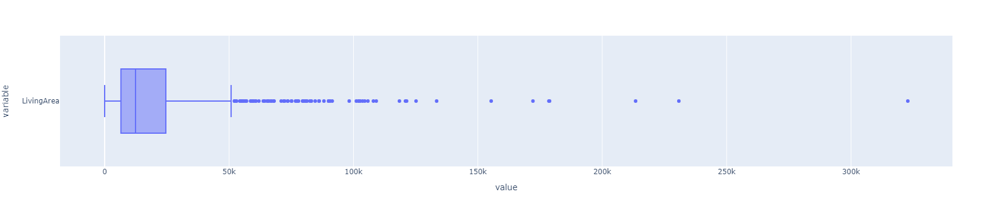

In [405]:
px.box(S['LivingArea'], orientation='h')

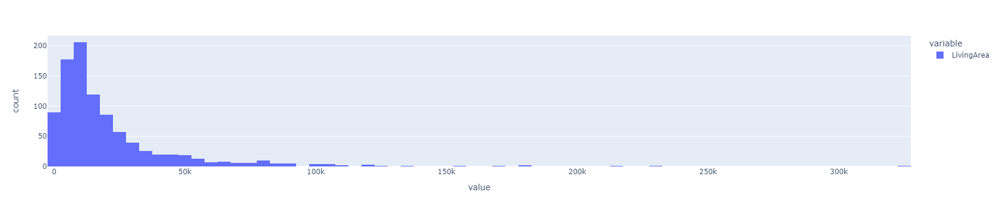

In [407]:
px.histogram(S['LivingArea'])

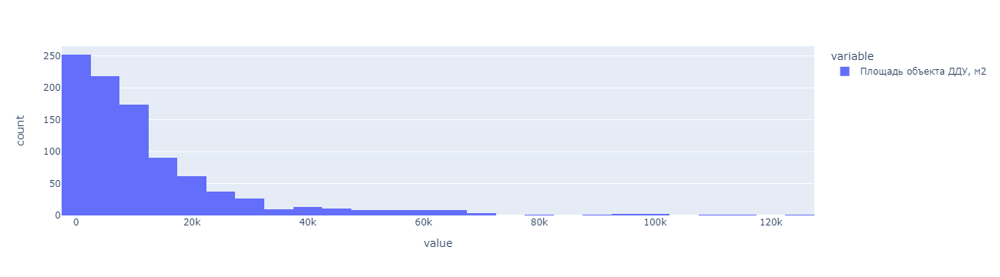

In [408]:
px.histogram(S['Площадь объекта ДДУ, м2'])

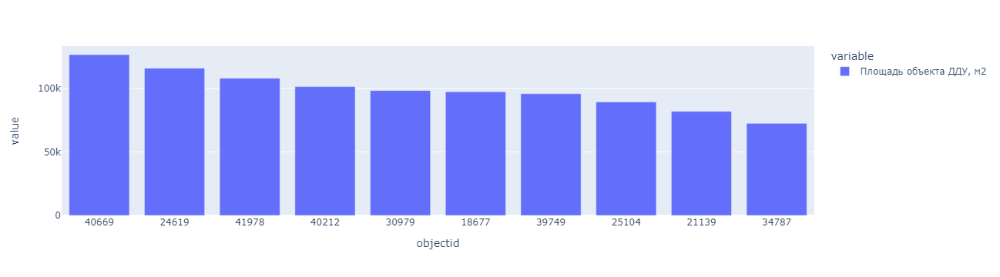

In [409]:
px.bar(S.set_index(S.index.astype('str')).nlargest(10, ['Площадь объекта ДДУ, м2'])['Площадь объекта ДДУ, м2'])

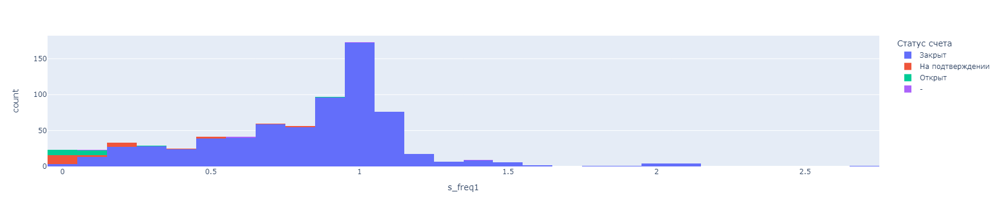

In [410]:
freq_s = S.assign(s_freq = S['Площадь объекта ДДУ, м2']/S['livingArea'], s_freq1 = S['Площадь объекта ДДУ, м2']/S['LivingArea']).dropna()

px.histogram(freq_s[(freq_s['s_freq'] < freq_s['s_freq'].quantile(0.9)) &
                    ~((freq_s['Статус счета'] == 'Закрыт') & (freq_s['Площадь объекта ДДУ, м2'] < 500))], x = 's_freq1', color = 'Статус счета')

In [367]:
df_f.query('objectid == 8996')['Площадь объекта ДДУ, м2'].sum()

23438.0

## Анализ цен за квадратный метр

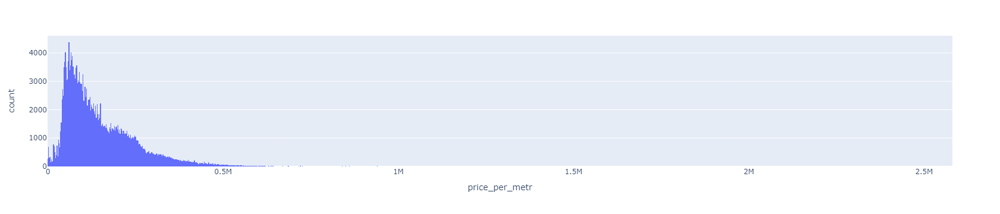

In [374]:
px.histogram(df_f[df_f['price_per_metr'] < df_f['price_per_metr'].quantile(0.9999)], x = 'price_per_metr')

In [375]:
df_ff = df_f.assign(price_per_metr = df_f['Сумма по ДДУ'] / df_f['Площадь объекта ДДУ, м2']).groupby(['objectid'], as_index = False).apply(
                                lambda df: anomaly_detect(df, ['price_per_metr'], fill = True)).reset_index()

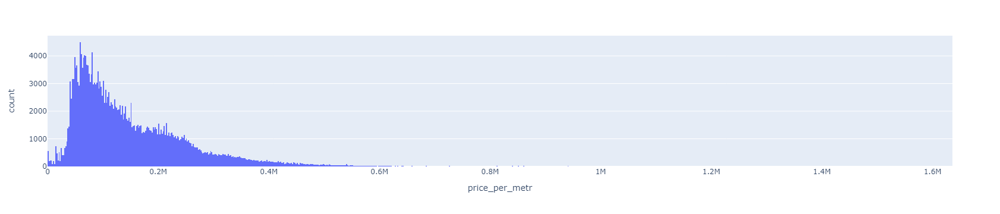

In [376]:
px.histogram(df_ff, x = 'price_per_metr')

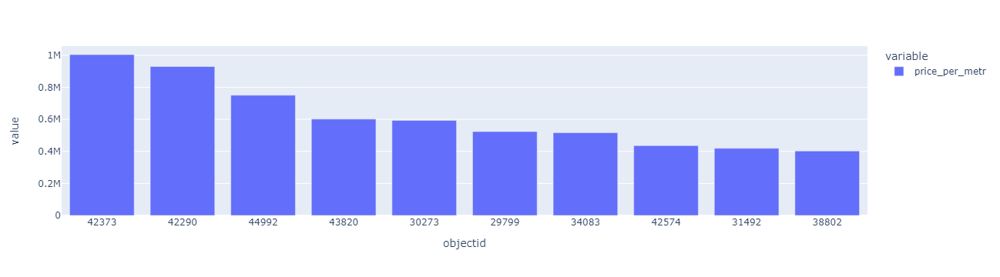

In [377]:
px.bar(df_ff.groupby(['objectid'], as_index = False).agg(
    {'price_per_metr': 'mean'}).nlargest(10, ['price_per_metr']).astype({'objectid': 'str'}).set_index('objectid'))

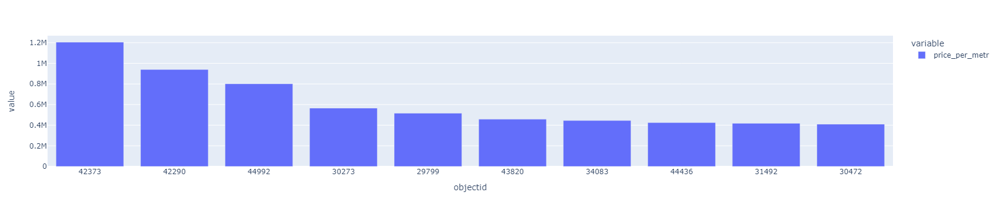

In [378]:
px.bar(df_ff.groupby(['objectid'], as_index = False).agg(
    {'price_per_metr': 'median'}).nlargest(10, ['price_per_metr']).astype({'objectid': 'str'}).set_index('objectid'))

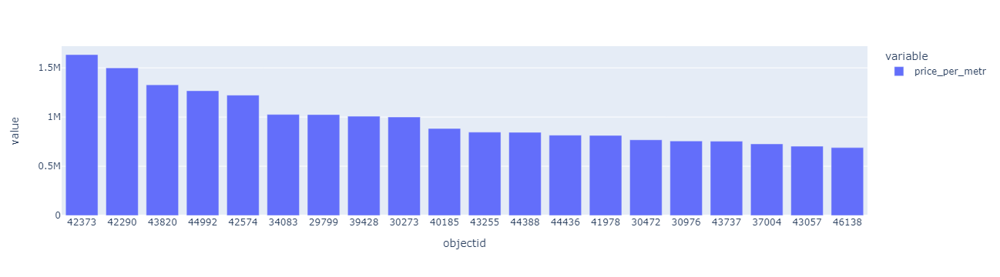

In [379]:
max_s_obj = df_ff.groupby(['objectid'], as_index = False).agg(
                        {'price_per_metr': 'max'}).nlargest(20, ['price_per_metr'])


px.bar(max_s_obj.astype({'objectid': 'str'}).set_index('objectid'))

#### -Объекты с самой большой ценой на кв. метр 

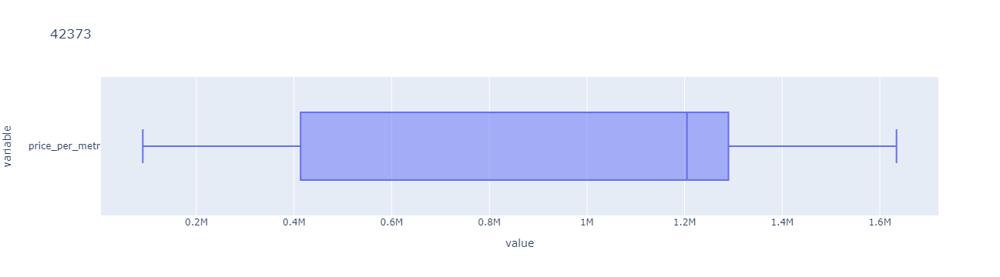

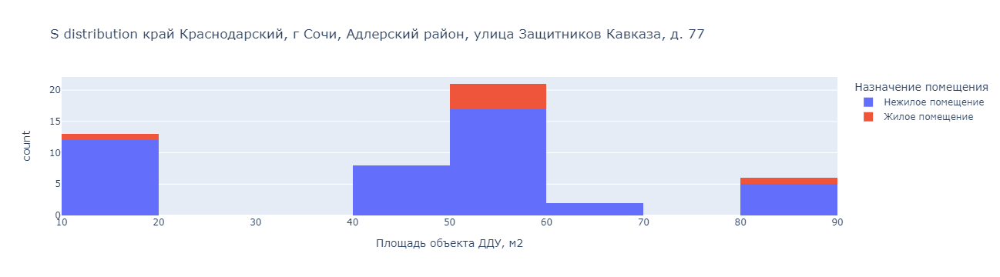

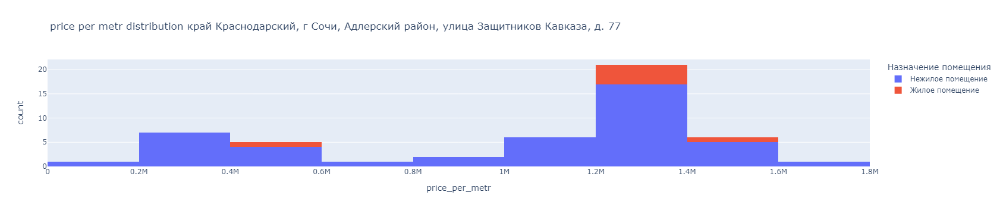

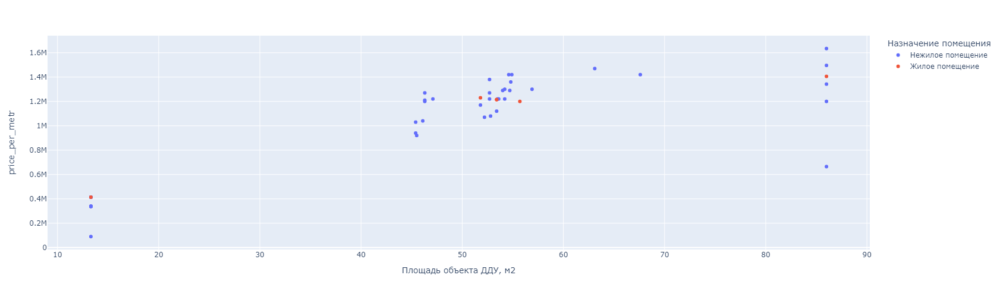

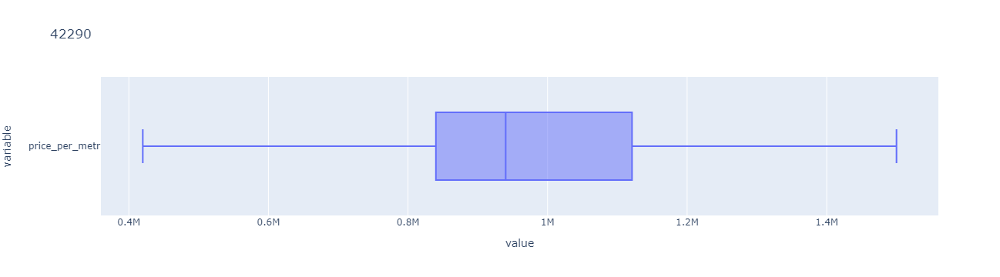

...

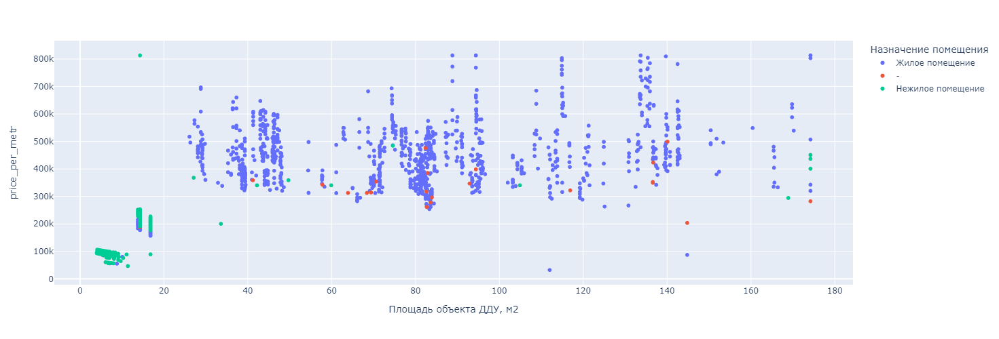

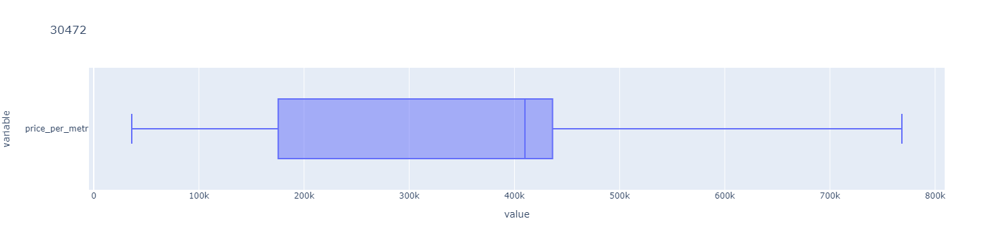

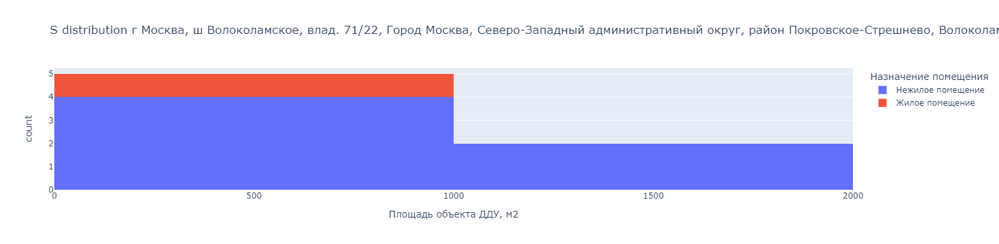

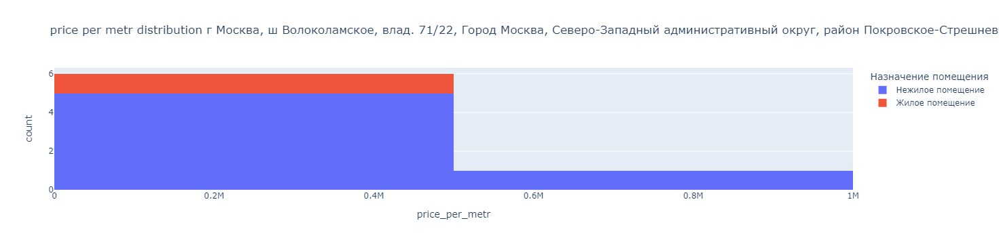

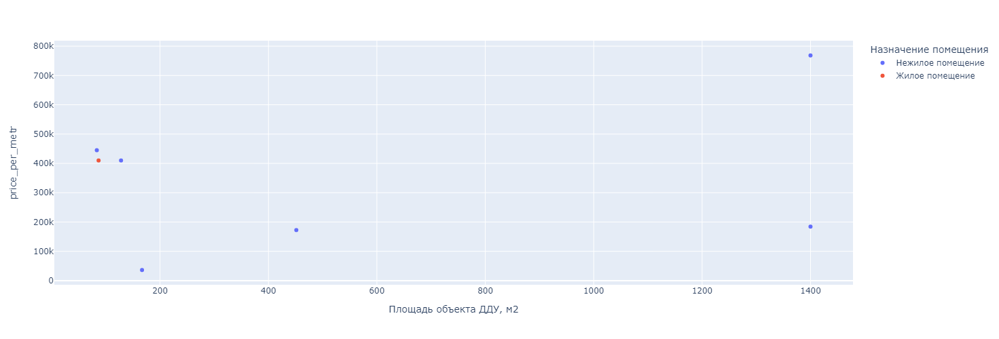

In [392]:
for obj in max_s_obj['objectid'].values[:15]:
    addr = df_ff.query(f'objectid == {obj}')['addressString'].iloc[0]
    px.box(df_ff.query(f'objectid == {obj}')['price_per_metr'], orientation = 'h', title=str(obj)).show()
    
    px.histogram(df_ff.query(f'objectid == {obj}'), x = 'Площадь объекта ДДУ, м2', color = 'Назначение помещения',
                 title=f'S distribution {addr}').show()
    px.histogram(df_ff.query(f'objectid == {obj}'), x = 'price_per_metr', color = 'Назначение помещения', 
                 title=f'price per metr distribution {addr}').show()
    
    px.scatter(df_ff.query(f'objectid == {obj}'), x = 'Площадь объекта ДДУ, м2', y = 'price_per_metr', color = 'Назначение помещения', width=600, height=500).show()
    #px.scatter(df_ff.query(f'objectid == {obj}'), x = 'Площадь объекта ДДУ, м2', y = 'price_per_metr', color = 'Владелец счета', width=600, height=500).show()
    print('\n'*3)

In [389]:
df_ff

,index,objectid,number_clean,number,complexId,developerId,groupId,address_additionalInfo,address_building,address_district,address_domain,address_house,address_letter,address_localityName,address_localityType,address_region_code,address_region_name,address_streetName,address_streetType,address_unit,addressString,buildRegion_code,buildRegion_name,latitude,longitude,livingArea,objectStatus_code,objectStatus_name,projectDeclaration_number,commissioningPlanDate,issuedate,issuedby,Дата открытия счета,Плановая дата окончания,Код Филиала,Код ТП,Статус счета,Номер счета эскроу,Текущий остаток по счету,в т.ч. собственные средства,в т.ч. ипотечные средства,Наименование получателя,ИНН получателя,БИК банка получателя,Расчетный счет получателя,Номер ДДУ,Дата ДДУ,Адрес объекта недвижимости,"Площадь объекта ДДУ, м2",Номер разрешения на строительство,Номер корпуса объекта ДДУ,Сумма по ДДУ,Сегмент застройщика,ОГРН застройщика,Дата регистрации ДДУ,ДДУ с несколькими участниками долевого строительства,Дата выдачи разрешения на строительство,"Баланс денежных средств на счете, согласно ДДУ","Баланс собственных денежных средств на счете, согласно ДДУ","Баланс ипотечных средств ВТБ на счете, согласно ДДУ","Баланс ипотечных средств другого банка на счете, согласно ДДУ","Баланс средств материнского капитала на счете, согласно ДДУ","Баланс средств военной ипотеки на счете, согласно ДДУ","Баланс прочих средств на счете, согласно ДДУ",Баланс ипотечных средств другого банка на счете,Баланс средств материнского капитала на счете,Баланс средств военной ипотеки на счете,Баланс прочих средств на счете,Последняя дата пополнения счета,Последняя сумма пополнения счета,Фактическая дата закрытия счета,Владелец счета,Назначение помещения,LivingArea,price_per_metr
0,0,45816,020330800010802018,02-RU03308000-1080Ж-2018,3110.0,13286,NaN,None,None,None,None,None,1.5.2,Уфа,г,2,Башкортостан Республика,На участке 1.5.2 северо-восточнее улицы Генера...,None,None,"Респ Башкортостан, г Уфа, На участке 1.5.2 сев...",2,Башкортостан Республика,54.716584,55.848830,7976.4,1,Строится,02-001377,2023-09-30,2021-06-22,Администрация городского округа город Уфа Респ...,2022-05-06,2024-04-30,018,2362,Закрыт,40824810123626000189,0.0,0.0,0.0,"ООО ""СЗ ""НД - 1.5.2 КПД""",0276952649,044525411,40702810623620001105,125-В/1-5-2/0422-ЭС,2022-04-22,"г. Уфа, на участке 1.5.2 северо-восточнее улиц...",58.90,02-RU03308000-1080Ж-2018,В,4245512.0,СМБ,1200200031162,NaT,Нет,2021-06-22,4245512.0,4245512.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaT,NaN,2023-03-03,ФЛ,Жилое помещение,20577.05,72080.0
1,1,45816,020330800010802018,02-RU03308000-1080Ж-2018,3110.0,13286,NaN,None,None,None,None,None,1.5.2,Уфа,г,2,Башкортостан Республика,На участке 1.5.2 северо-восточнее улицы Генера...,None,None,"Респ Башкортостан, г Уфа, На участке 1.5.2 сев...",2,Башкортостан Республика,54.716584,55.848830,7976.4,1,Строится,02-001377,2023-09-30,2021-06-22,Администрация городского округа город Уфа Респ...,2022-05-13,2024-03-30,018,3262,Закрыт,40824810832626000014,0.0,0.0,0.0,"ООО ""СЗ ""НД - 1.5.2 КПД""",0276952649,044525411,40702810623620001105,348-Ж/1-5-2/0522-ЭС,2022-05-13,"Респ Башкортостан, г Уфа, На участке 1. 5 .2 с...",52.80,02-RU03308000-1080Ж-2018,Ж,3769920.0,СМБ,1200200031162,2022-05-23,Да,2021-06-22,3769920.0,0.0,0.0,3769920.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2023-11-03,-3769920.0,2023-11-03,ФЛ,Жилое помещение,20577.05,71400.0
2,2,45816,020330800010802018,02-RU03308000-1080Ж-2018,3110.0,13286,NaN,None,None,None,None,None,1.5.2,Уфа,г,2,Башкортостан Республика,На участке 1.5.2 северо-восточнее улицы Генера...,None,None,"Респ Башкортостан, г Уфа, На участке 1.5.2 сев...",2,Башкортостан Республика,54.716584,55.848830,7976.4,1,Строится,02-001377,2023-09-30,2021-06-22,Администрация городского округа город Уфа Респ...,2022-05-23,2024-03-31,018,2362,Закрыт,40824810823626000191,0.0,0.0,0.0,"ООО ""СЗ ""НД - 1.5.2 КПД""",0276952649,044525411,40702810623620001105,180-Г/1-5-2/0522-ЭС,2022-05-24,"Респ Башкортостан, г Уфа, На участке 1.5.

In [ ]:
def cross_join(df):
    start_date = pd.to_datetime(df['Дата открытия счета'].values[0])
    
    end_date = pd.to_datetime(df['Плановая дата окончания'].values[0]) if \
            pd.isnull(df['commissioningPlanDate'].values[0]) else min(pd.to_datetime(df['commissioningPlanDate'].values[0]), pd.to_datetime('2024-12-31'))
    try:
        dates_df = pd.DataFrame({'report_date': pd.date_range(start_date + MonthEnd(0), end_date + MonthEnd(0), freq = 'M')})
        return df.merge(dates_df, how = 'cross')
    except:
        return df


dff = df.groupby(['Номер счета эскроу'], as_index = False).apply(lambda df: cross_join(df)).reset_index(drop = True)


In [7]:
dff['number_clean'].nunique()

740

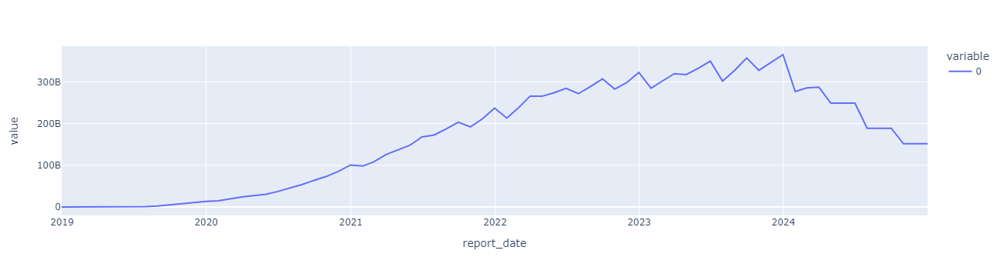

In [5]:
px.line(dff.groupby(['report_date']).apply(lambda df: df['Общая сумма по ДДУ'].abs().sum()))

In [8]:
dff.to_parquet('escrow_monthly.parquet')

In [9]:
df[['Дата открытия ', 'Плановая дата окончания','Фактическая дата закрытия счета', 'Номер счета эскроу', 'Общая сумма по ДДУ']]

,Дата открытия,Плановая дата окончания,Фактическая дата закрытия счета,Номер счета эскроу,Общая сумма по ДДУ
4,2019-07-30 00:00:00,2019-07-30 00:00:00,2019-07-30 00:00:00,40824810831036000011,0
5,2019-07-31 00:00:00,2019-07-31 00:00:00,2019-07-31 00:00:00,40824810231036000019,0
6,2019-08-01 00:00:00,2019-08-01 00:00:00,2019-08-01 00:00:00,40824810131036000025,0
7,2019-08-02 00:00:00,2019-08-02 00:00:00,2019-08-02 00:00:00,40824810010256000010,0
8,2019-08-02 00:00:00,2019-08-02 00:00:00,2019-08-02 00:00:00,40824810031036000028,0
...,...,...,...,...,...
226807,2024-02-02 00:00:00,2025-06-30 00:00:00,-,40824810735268000213,10340924
226808,2024-02-09 00:00:00,2025-06-30 00:00:00,-,40824810310278000154,11591360
226809,2024-02-17 00:00:00,2025-06-30 00:00:00,-,40824810019108000363,8038140
226810,2024-03-01 00:00:00,2025-06-30 00:00:00,-,40824810823258000506,13089510


In [14]:
df['Фактическая дата закрытия счета'].iloc[1]

datetime.datetime(2019, 7, 31, 0, 0)